# 積上げ密度プロット[^area]

[^area]: 狭義には、確率密度を積上げたもののみを「積上げ密度プロット」と呼ぶこともあります。本書では便宜上、確率密度以外を対象とした場合も「積上げ密度プロット」と呼びます。

## 準備

### Import

In [1]:
# warningsモジュールのインポート
import warnings

# データ解析や機械学習のライブラリ使用時の警告を非表示にする目的で警告を無視
# 本書の文脈では、可視化の学習に議論を集中させるために選択した
# ただし、学習以外の場面で、警告を無視する設定は推奨しない
warnings.filterwarnings("ignore")

In [2]:
# itertoolsモジュールのインポート
# 効率的なループを実行するためのイテレータビルディングブロックを提供
# これにより、データのコンビネーションや順列などを簡潔に表現できる
import itertools

# pathlibモジュールのインポート
# ファイルシステムのパスを扱う
from pathlib import Path

# typingモジュールのインポート
# 型ヒント（Type Hints）のための様々な型（Type）を提供
from typing import Any, List, Optional

# numpy：数値計算ライブラリのインポート
# npという名前で参照可能
import numpy as np

# pandas：データ解析ライブラリのインポート
# pdという名前で参照可能
import pandas as pd

# plotly.expressのインポート
# インタラクティブなグラフ作成のライブラリ
# pxという名前で参照可能
import plotly.express as px

# plotly.graph_objectsのインポート
# goという名前で参照可能
# 低レベルのインターフェイスを提供し、より詳細なカスタマイズが可能
import plotly.graph_objects as go

# plotly.graph_objectsからFigureクラスのインポート
# 型ヒントの利用を主目的とする
from plotly.graph_objects import Figure

# plotly.subplotsのインポート
# make_subplots関数を提供
# 複数のグラフを一つの図に組み合わせることが可能
from plotly.subplots import make_subplots

### 変数

In [3]:
# マンガデータ保存ディレクトリのパス
DIR_CM = Path("../../../data/cm/input")
# アニメデータ保存ディレクトリのパス
DIR_AN = Path("../../../data/an/input")
# ゲームデータ保存ディレクトリのパス
DIR_GM = Path("../../../data/gm/input")

# マンガデータの分析結果の出力先ディレクトリのパス
DIR_OUT_CM = (
    DIR_CM.parent / "output" / Path.cwd().parts[-2] / Path.cwd().parts[-1] / "area"
)
# アニメデータの分析結果の出力先ディレクトリのパス
DIR_OUT_AN = (
    DIR_AN.parent / "output" / Path.cwd().parts[-2] / Path.cwd().parts[-1] / "area"
)
# ゲームデータの分析結果の出力先ディレクトリのパス
DIR_OUT_GM = (
    DIR_GM.parent / "output" / Path.cwd().parts[-2] / Path.cwd().parts[-1] / "area"
)

In [4]:
# 読み込み対象ファイル名の定義

# マンガ作品とマンガ作者の対応関係に関するファイル
FN_CC_CRT = "cm_cc_crt.csv"

# マンガ各話に関するファイル
FN_CE = "cm_ce.csv"

# アニメ作品と原作者の対応関係に関するファイル
FN_AC_ACT = "an_ac_act.csv"

# アニメ各話に関するファイル
FN_AE = "an_ae.csv"

# ゲームパッケージとプラットフォームの対応関係に関するファイル
FN_PKG_PF = "gm_pkg_pf.csv"

In [5]:
# plotlyの描画設定の定義

# plotlyのグラフ描画用レンダラーの定義
# Jupyter Notebook環境のグラフ表示に適切なものを選択
RENDERER = "plotly_mimetype+notebook"

In [6]:
# 可視化に関する設定値の定義

# 「年代」の集計単位
UNIT_YEARS = 10

In [7]:
# pandasのweekday関数で取得できる曜日の数値と実際の曜日名を対応させる辞書を定義
# 0:月曜日, 1:火曜日, ... , 6:日曜日
WEEKDAY2YOBI = {
    0: "月",
    1: "火",
    2: "水",
    3: "木",
    4: "金",
    5: "土",
    6: "日",
}

In [8]:
# 質的変数の描画用のカラースケールの定義

# Okabe and Ito (2008)基準のカラーパレット
# 色の識別性が高く、多様な色覚の人々にも見やすい色組み合わせ
# 参考URL: https://jfly.uni-koeln.de/color/#pallet
OKABE_ITO = [
    "#000000",  # 黒 (Black)
    "#E69F00",  # 橙 (Orange)
    "#56B4E9",  # 薄青 (Sky Blue)
    "#009E73",  # 青緑 (Bluish Green)
    "#F0E442",  # 黄色 (Yellow)
    "#0072B2",  # 青 (Blue)
    "#D55E00",  # 赤紫 (Vermilion)
    "#CC79A7",  # 紫 (Reddish Purple)
]

### 関数

In [9]:
def show_fig(fig: Figure) -> None:
    """
    所定のレンダラーを用いてplotlyの図を表示
    Jupyter Bookなどの環境での正確な表示を目的とする

    Parameters
    ----------
    fig : Figure
        表示対象のplotly図

    Returns
    -------
    None
    """

    # 図の周囲の余白を設定
    # t: 上余白
    # l: 左余白
    # r: 右余白
    # b: 下余白
    fig.update_layout(margin=dict(t=25, l=25, r=25, b=25))

    # 所定のレンダラーで図を表示
    fig.show(renderer=RENDERER)

In [10]:
def add_years_to_df(
    df: pd.DataFrame, unit_years: int = UNIT_YEARS, col_date: str = "date"
) -> pd.DataFrame:
    """
    データフレームにunit_years単位で区切った年数を示す新しい列を追加

    Parameters
    ----------
    df : pd.DataFrame
        入力データフレーム
    unit_years : int, optional
        年数を区切る単位、デフォルトはUNIT_YEARS
    col_date : str, optional
        日付を含むカラム名、デフォルトは "date"

    Returns
    -------
    pd.DataFrame
        新しい列が追加されたデータフレーム
    """

    # 入力データフレームをコピー
    df_new = df.copy()

    # unit_years単位で年数を区切り、新しい列として追加
    df_new["years"] = (
        pd.to_datetime(df_new[col_date]).dt.year // unit_years * unit_years
    )

    # 'years'列のデータ型を文字列に変更
    df_new["years"] = df_new["years"].astype(str)

    return df_new

In [11]:
def resample_df_by_col_and_years(df: pd.DataFrame, col: str) -> pd.DataFrame:
    """
    指定されたカラムと年数に基づき、データフレームを再サンプル
    colとyearsの全ての組み合わせが存在するように0埋めを行う
    この処理は、作図時にX軸方向の順序が変わることを防ぐために必要

    Parameters
    ----------
    df : pd.DataFrame
        入力データフレーム
    col : str
        サンプリング対象のカラム名

    Returns
    -------
    pd.DataFrame
        再サンプルされたデータフレーム
    """

    # 入力データフレームを新しい変数にコピー
    df_new = df.copy()

    # データフレームからユニークな年数一覧を取得
    unique_years = df["years"].unique()

    # データフレームからユニークなcolの値一覧を取得
    unique_vals = df[col].unique()

    # 一意なカラムの値と年数の全ての組み合わせに対して処理
    for val, years in itertools.product(unique_vals, unique_years):
        # 対象のカラムの値と年数が一致するデータを抽出
        df_tmp = df_new[(df_new[col] == val) & (df_new["years"] == years)]

        # 該当するデータが存在しない場合
        if df_tmp.shape[0] == 0:
            # 0埋めのデータを作成
            default_data = {c: 0 for c in df_tmp.columns}
            # col列についてはvalで埋める
            default_data[col] = val
            # years列についてはyearで埋める
            default_data["years"] = years
            # 新たなレコードとして追加
            df_add = pd.DataFrame(default_data, index=[0])

            # 0埋めのデータをデータフレームに追加
            df_new = pd.concat([df_new, df_add], ignore_index=True)

    return df_new

In [12]:
def add_background_trace(
    fig: Figure,
    row: int,
    col: int,
    x: List[Any],
    y: List[Any],
    fillcolor: str = "lightgrey",
    name: str = "合計",
) -> Figure:
    """
    指定されたFigureに全数の推移を背景として追加

    Parameters
    ----------
    fig : Figure
        更新されるPlotly Figureオブジェクト
    row : int
        サブプロットの行位置
    col : int
        サブプロットの列位置
    x : List[Any]
        X軸のデータ
    y : List[Any]
        Y軸のデータ
    fillcolor : str, optional
        塗りつぶしの色
    name : str, optional
        トレースの名前（凡例に表示される）

    Returns
    -------
    Figure
        更新されたFigureオブジェクト
    """
    fig.add_trace(
        go.Scatter(
            x=x, y=y, fill="tozeroy", mode="none", fillcolor=fillcolor, name=name
        ),
        row=row,
        col=col,
    )
    return fig

In [13]:
def add_density_plot(
    fig: Figure,
    row: int,
    col: int,
    x: List[Any],
    y: List[Any],
    fillcolor: str = "orange",
    linecolor: str = "red",
    name: Optional[str] = None,
) -> Figure:
    """
    指定されたFigureに積上げ密度プロットを追加する

    Parameters
    ----------
    fig : Figure
        更新されるPlotly Figureオブジェクト
    row : int
        サブプロットの行位置
    col : int
        サブプロットの列位置
    x : List[Any]
        X軸のデータ
    y : List[Any]
        Y軸のデータ
    fillcolor : str, optional
        塗りつぶしの色
    linecolor : str, optional
        線の色
    name : Optional[str], optional
        トレースの名前（凡例に表示される）

    Returns
    -------
    Figure
        更新されたFigureオブジェクト
    """
    fig.add_trace(
        go.Scatter(
            x=x,
            y=y,
            fill="tozeroy",
            fillcolor=fillcolor,
            line=dict(color=linecolor),
            name=name,
        ),
        row=row,
        col=col,
    )
    return fig

In [14]:
def filter_gender_and_reset_index(df: pd.DataFrame, gender: str) -> pd.DataFrame:
    """
    特定の性別でデータをフィルタリングし、インデックスをリセットする

    Parameters
    ----------
    df : pd.DataFrame
        分析対象のデータフレーム
    gender : str
        フィルタリングする性別（'male' または 'female'）

    Returns
    -------
    pd.DataFrame
        フィルタリングされ、インデックスがリセットされたデータフレーム

    """
    # データフレームから指定された性別のデータのみを選択
    df_filtered = df[df["性別"] == gender]

    # インデックスをリセット（古いインデックスは削除）
    return df_filtered.reset_index(drop=True)

In [15]:
def add_gender_pyramid_trace(
    fig: go.Figure, df: pd.DataFrame, gender: str, col: int
) -> go.Figure:
    """
    人口ピラミッドのトレースを図に追加する

    Parameters
    ----------
    fig : go.Figure
        追加先の図
    df : pd.DataFrame
        データフレーム、声優数と放送年が含まれている必要がある
    gender : str
        性別を示す文字列（'男性' または '女性'）
    col : int
        トレースを追加する列の番号

    Returns
    -------
    go.Figure
        トレースが追加された図
    """
    # 人口ピラミッドのトレースを図に追加
    fig.add_trace(
        go.Scatter(
            x=df["声優数"],
            y=df["年"],
            orientation="h",
            fill="tozerox",
            fillcolor="orange",
            line=dict(color="red"),
            showlegend=False,
            name=gender,
        ),
        row=1,
        col=col,
    )

    # 修正された図を返す
    return fig

In [16]:
def save_df_to_csv(df: pd.DataFrame, dir_save: Path, fn_save: str) -> None:
    """
    DataFrameをCSVファイルとして指定されたディレクトリに保存する関数

    Parameters
    ----------
    df : pd.DataFrame
        保存対象となるDataFrame
    dir_save : Path
        出力先ディレクトリのパス
    fn_save : str
        保存するCSVファイルの名前（拡張子は含めない）
    """
    # 出力先ディレクトリが存在しない場合は作成
    dir_save.mkdir(parents=True, exist_ok=True)

    # 出力先のパスを作成
    p_save = dir_save / f"{fn_save}.csv"

    # DataFrameをCSVファイルとして保存する
    df.to_csv(p_save, index=False, encoding="utf-8-sig")

    # 保存完了のメッセージを表示する
    print(f"DataFrame is saved as '{p_save}'.")

## 可視化例

(area-cm)=
### マンガデータ

In [17]:
# pandasのread_csv関数でCSVファイルの読み込み
df_cc_crt = pd.read_csv(DIR_CM / FN_CC_CRT)
df_ce = pd.read_csv(DIR_CM / FN_CE)

In [18]:
# crtidごとのmcid数を集計し、n_mc列として追加した中間DataFrame
df_tmp = df_cc_crt.groupby("crtid")["mcid"].nunique().reset_index(name="n_mc")
# 複数のマンガ雑誌に掲載経験のあるcrtid一覧をリスト化
crtids2drop = df_tmp[df_tmp["n_mc"] > 1]["crtid"].to_list()
# df_cc_crtからcrtid2dropに含まれる行を削除
df_cc_crt = df_cc_crt[~df_cc_crt["crtid"].isin(crtids2drop)].reset_index(drop=True)

In [19]:
# 各crtidに対して、関連するmcnameのユニークな数を数える
# groupbyでcrtidごとにグループ化し、nuniqueメソッドで各グループのmcnameのユニークな数を数える
# all関数を使って、nuniqueの結果が全て1であること（各crtidが1つのmcnameにのみ紐づいていること）を確認
assert all(df_cc_crt.groupby("crtid")["mcname"].nunique() == 1)

In [20]:
# df_ceに年代情報を追加するための関数add_years_to_dfを適用
# unit_years=1とすることで、一年単位で集計
df_ce = add_years_to_df(df_ce, unit_years=1)

# yearsとccidのユニークな組み合わせを持つデータフレームを作成
# 重複するデータを削除し、必要なカラムのみを選択
# ignore_index=Trueで新しいインデックスを割り当てている
df_cc_years = df_ce.drop_duplicates(subset=["years", "ccid"], ignore_index=True)[
    ["ccid", "years"]
]

In [21]:
# df_cc_crtとdf_cc_yearsをccidを基準にして右結合（right join）し、df_mergeを作成
# これにより、df_cc_crtのデータにdf_cc_yearsのyears情報が組み合わされる
df_merge = pd.merge(df_cc_crt, df_cc_years, on="ccid", how="right")

# df_mergeをマンガ雑誌名とyearsごとにグループ化し、作者のユニーク数を集計
# nunique()を使用して各グループ内のユニークな作者数をカウント
df_cm = (
    df_merge.groupby(["mcname", "years"])["crtid"].nunique().reset_index(name="n_crt")
)

# years別の比率を計算するための一時的なDataFrameを作成し、マージ
df_tmp = df_cm.groupby("years")["n_crt"].sum().reset_index(name="years_total")
df_cm = pd.merge(df_cm, df_tmp, how="left", on="years")

# years別のマンガ作者数のシェアを計算
df_cm["ratio"] = df_cm["n_crt"] / df_cm["years_total"]
# 可視化した際の補足情報として、小数点以下2桁で丸めたシェアを計算
df_cm["text"] = df_cm["ratio"].apply(lambda x: f"{x: .2}")

# 列名をわかりやすい名前に変更
df_cm = df_cm.rename(
    columns={
        "mcname": "マンガ雑誌名",
        "years": "年",
        "n_crt": "マンガ作者数",
        "ratio": "マンガ作者数のシェア",
    }
)

In [22]:
# 年別のyears_total一覧を確認
# 同年に対して同じyears_totalが格納されているため、それぞれ最初の一つ目を表示
df_cm.groupby("年")["years_total"].first().reset_index()

,年,years_total
0,1970,65
1,1971,98
2,1972,101
3,1973,88
4,1974,49
5,1975,56
6,1976,69
7,1977,72
8,1978,84
9,1979,99


In [23]:
# 可視化対象のDataFrameを確認
df_cm.head()

,マンガ雑誌名,年,マンガ作者数,years_total,マンガ作者数のシェア,text
0,週刊少年サンデー,1970,13,65,0.200000,0.2
1,週刊少年サンデー,1971,28,98,0.285714,0.29
2,週刊少年サンデー,1972,19,101,0.188119,0.19
3,週刊少年サンデー,1973,21,88,0.238636,0.24
4,週刊少年サンデー,1974,10,49,0.204082,0.2


In [24]:
# 可視化対象DataFrameを保存
save_df_to_csv(df_cm, DIR_OUT_CM, "cm")

DataFrame is saved as '../../../data/cm/output/vol2/03/area/cm.csv'.


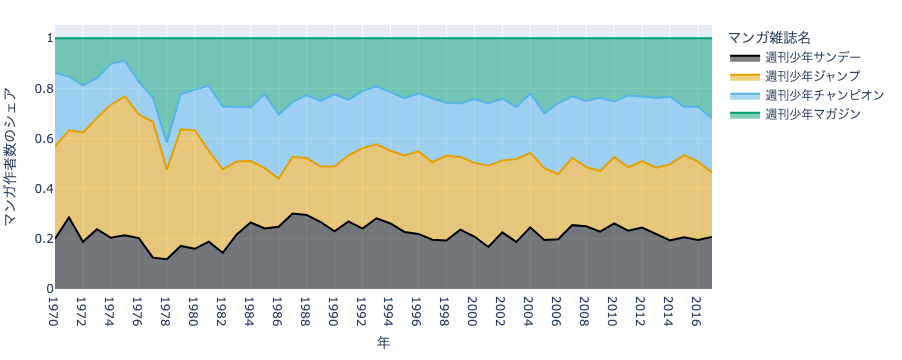

In [25]:
# 積上げ密度プロットを作成し、年ごとのマンガ作者数のシェアを可視化
# x軸に年、y軸にマンガ作者数のシェアを設定し、colorにマンガ雑誌名を指定
# color_discrete_sequenceで色の配列をOKABE_ITOカラースキームに設定
fig = px.area(
    df_cm,
    x="年",
    y="マンガ作者数のシェア",
    color="マンガ雑誌名",
    color_discrete_sequence=OKABE_ITO,
)

# x unifiedを指定することで、同じxに対する複数のyの値を同時に比較できる
fig.update_layout(hovermode="x unified")

# 積上げ密度プロットを表示
show_fig(fig)

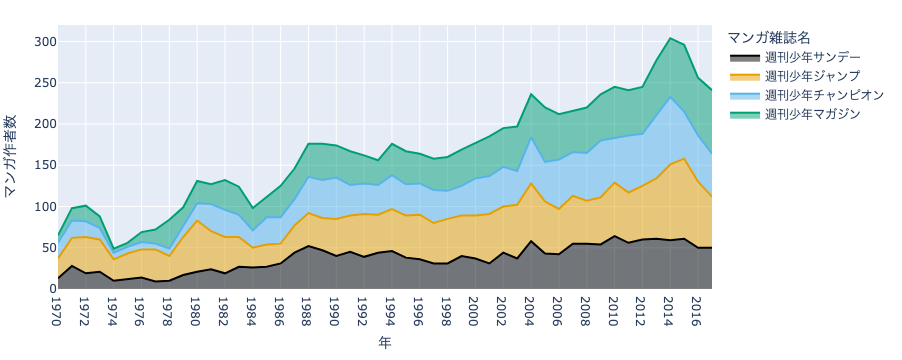

In [26]:
# 積上げ密度プロットを作成し、年ごとのマンガ作者数を可視化
# x軸に年、y軸にマンガ作者数を設定し、colorにマンガ雑誌名を指定
# color_discrete_sequenceで色の配列をOKABE_ITOカラースキームに設定
fig = px.area(
    df_cm,
    x="年",
    y="マンガ作者数",
    color="マンガ雑誌名",
    color_discrete_sequence=OKABE_ITO,
)

# x unifiedを指定することで、同じxに対する複数のyの値を同時に比較できる
fig.update_layout(hovermode="x unified")

# 積上げ密度プロットを表示
show_fig(fig)

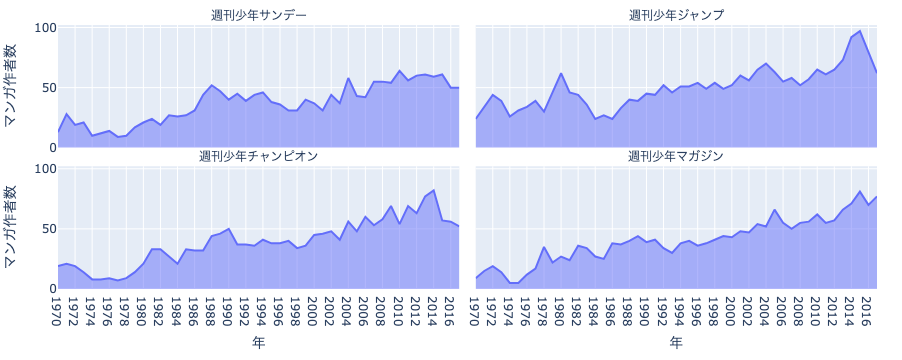

In [27]:
# マンガ雑誌ごとに積上げ密度プロットを作成し、年ごとのマンガ作者数を可視化
# x軸に年、y軸にマンガ作者数を設定し、facet_colにマンガ雑誌名を指定
# facet_col_wrap=2とすることで、2列のファセットを配置
fig = px.area(
    df_cm,
    x="年",
    y="マンガ作者数",
    facet_col="マンガ雑誌名",
    facet_col_wrap=2,
)

# ファセット（マンガ雑誌ごとの積み上げ密度プロット）のタイトルを簡潔にする処理
# デフォルトではタイトルは「マンガ雑誌名=xxx」という形式になっている
fig.for_each_annotation(lambda a: a.update(text=a.text.split("=")[-1]))

# 積み上げ密度プロットを表示
show_fig(fig)

In [28]:
# 全体の合計マンガ作者数のデータを計算
df_total = (
    df_cm.groupby("年")["マンガ作者数"].sum().reset_index(name="合計マンガ作者数")
)

# ユニークなマンガ雑誌名のリストを取得
mcnames = df_cm["マンガ雑誌名"].unique()

In [29]:
# 可視化対象のDataFrameを確認
df_total.head()

,年,合計マンガ作者数
0,1970,65
1,1971,98
2,1972,101
3,1973,88
4,1974,49


In [30]:
# 可視化対象DataFrameを保存
save_df_to_csv(df_total, DIR_OUT_CM, "total")

DataFrame is saved as '../../../data/cm/output/vol2/03/area/total.csv'.


(area-cm-facet)=

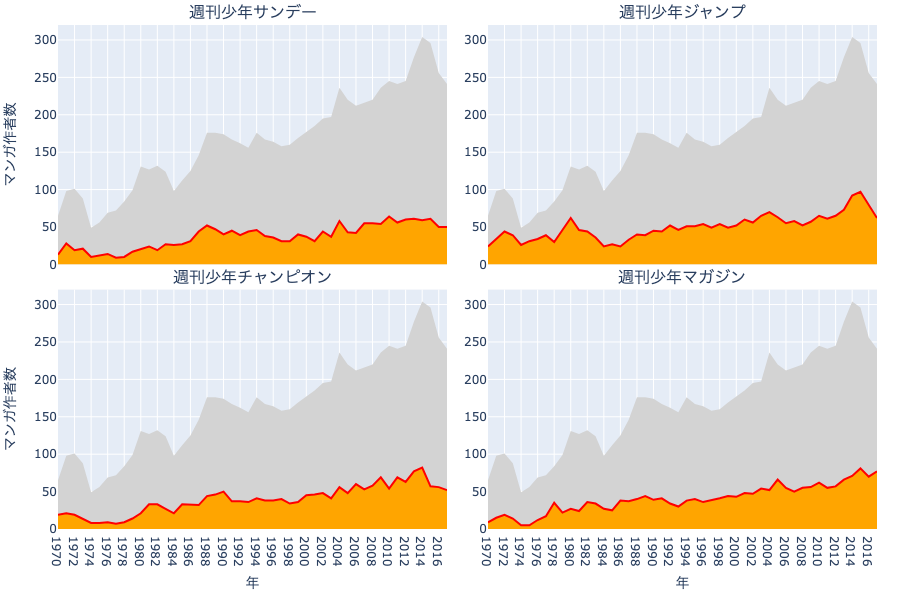

In [31]:
# サブプロットの作成（2行2列のレイアウト）
# shared_xaxes=Trueで全てのサブプロットが同じx軸を共有するように設定
# subplot_titlesにマンガ雑誌名を指定して各サブプロットにタイトルを設定
# horizontal_spacingとvertical_spacingでファセット間の間隔を調整
fig = make_subplots(
    rows=2,
    cols=2,
    shared_xaxes=True,
    subplot_titles=mcnames,
    horizontal_spacing=0.05,
    vertical_spacing=0.05,
)

# 各マンガ雑誌に対してプロットを追加
for i, mcname in enumerate(mcnames):
    # 行(row)と列(col)の位置を計算（2行2列のレイアウトを想定）
    row, col = i // 2 + 1, i % 2 + 1

    # マンガ雑誌名でデータをフィルタリング
    df_subset = df_cm[df_cm["マンガ雑誌名"] == mcname]

    # 全体の合計マンガ作者数の推移を背景に追加
    fig = add_background_trace(
        fig, row, col, df_total["年"], df_total["合計マンガ作者数"]
    )

    # マンガ雑誌別の積上げ密度プロットを追加
    fig = add_density_plot(
        fig, row, col, df_subset["年"], df_subset["マンガ作者数"], name=mcname
    )

# グラフのレイアウトを調整
# heightでグラフ全体の高さを設定し、showlegend=Falseで凡例を非表示に
fig.update_layout(height=600, showlegend=False)

# y軸のタイトルを左側のサブプロット全てに設定
for row in range(1, 3):
    fig.update_yaxes(title_text="マンガ作者数", row=row, col=1)

# x軸のタイトルを下側のサブプロット全てに設定
for col in range(1, 3):
    fig.update_xaxes(title_text="年", row=2, col=col)

# x unifiedを指定することで、同じxに対する複数のyの値を同時に比較できる
fig.update_layout(hovermode="x unified")

# グラフを表示
show_fig(fig)

### アニメデータ

In [32]:
# pandasのread_csv関数でCSVファイルの読み込み
df_ac_act = pd.read_csv(DIR_AN / FN_AC_ACT)
df_ae = pd.read_csv(DIR_AN / FN_AE)

In [33]:
# 各crtidに対して、関連するgenderのユニークな数を数える
# groupbyでcrtidごとにグループ化し、nuniqueメソッドで各グループのgenderのユニークな数を数える
# all関数を使って、nuniqueの結果が全て1であること（各crtidが1つのgenderにのみ紐づいていること）を確認
assert all(df_ac_act.groupby("actid")["gender"].nunique() == 1)

In [34]:
# df_aeに年代情報を追加するための関数add_years_to_dfを適用
# unit_years=1を指定することで、1年単位の年代情報を追加する
df_ae = add_years_to_df(df_ae, unit_years=1)

# acidとyearsのユニークな組み合わせを持つDataFrameを作成
# 重複するデータを削除し、必要なカラムのみを選択
# ignore_index=Trueで新しいインデックスを割り当てる
df_ac_years = df_ae.drop_duplicates(subset=["acid", "years"], ignore_index=True)[
    ["acid", "years"]
]

In [35]:
# df_ac_actとdf_ac_yearsをacidを基準にして左結合（left join）し、df_mergeを作成
# これにより、df_ac_actのデータにdf_ac_yearsの年代情報が組み合わされる
df_merge = pd.merge(df_ac_act, df_ac_years, on="acid", how="left")

# df_mergeを性別と年代ごとにグループ化し、声優のユニーク数を集計
# nunique()を使用して各グループ内のユニークな声優数をカウント
df_an = (
    df_merge.groupby(["gender", "years"])["acid"].nunique().reset_index(name="n_act")
)

# 列名をわかりやすい名前に変更
df_an = df_an.rename(columns={"gender": "性別", "years": "年", "n_act": "声優数"})

(area-an-size)=

In [36]:
# 年別の声優数の合計値を集計
df_an.groupby("年")["声優数"].sum().reset_index()

,年,声優数
0,1963,4
1,1964,4
2,1965,4
3,1966,2
4,1971,2
5,1972,2
6,1974,4
7,1975,2
8,1979,2
9,1980,2


In [37]:
# df_anから、2000年以降のデータのみを抽出
df_an = df_an[df_an["年"].astype(int) >= 2000].reset_index(drop=True)

In [38]:
# 年ごとの合計声優数を格納する辞書を作成
year2nact = df_an.groupby("年")["声優数"].sum().to_dict()

# df_anに合計声優数という列を追加し、year2nactから値を取得して格納
df_an["合計声優数"] = df_an["年"].map(year2nact)

# df_anに内訳列を追加。声優数 / 合計声優数で算出
df_an["声優数のシェア"] = df_an["声優数"] / df_an["合計声優数"]

In [39]:
# 可視化対象のDataFrameを確認
df_an.head()

,性別,年,声優数,合計声優数,声優数のシェア
0,female,2000,127,252,0.503968
1,female,2001,145,287,0.505226
2,female,2002,147,288,0.510417
3,female,2003,173,342,0.505848
4,female,2004,202,407,0.496314


In [40]:
# 可視化対象DataFrameを保存
save_df_to_csv(df_an, DIR_OUT_AN, "an")

DataFrame is saved as '../../../data/an/output/vol2/03/area/an.csv'.


(area-an-prop)=

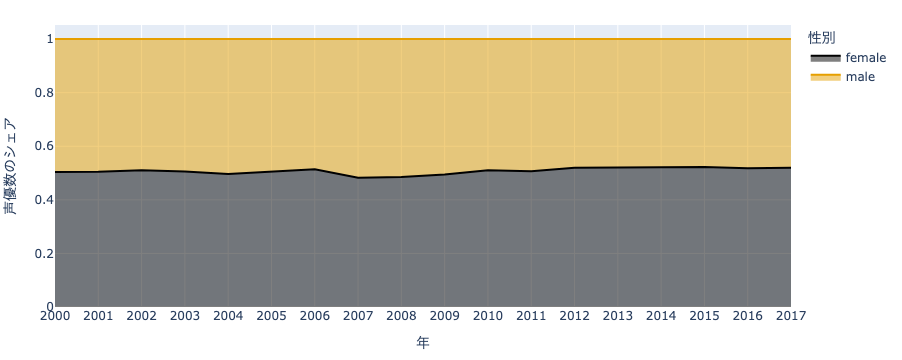

In [41]:
# 積上げ密度プロットを作成し、年ごとの声優数のシェアを可視化
# x軸に年、y軸に声優数のシェアを設定し、colorに性別を指定
# color_discrete_sequenceで色の配列をOKABE_ITOカラースキームに設定
fig = px.area(
    df_an, x="年", y="声優数のシェア", color="性別", color_discrete_sequence=OKABE_ITO
)

# x unifiedを指定することで、同じxに対する複数のyの値を同時に比較できる
fig.update_layout(hovermode="x unified")

# 積上げ密度プロットを表示
show_fig(fig)

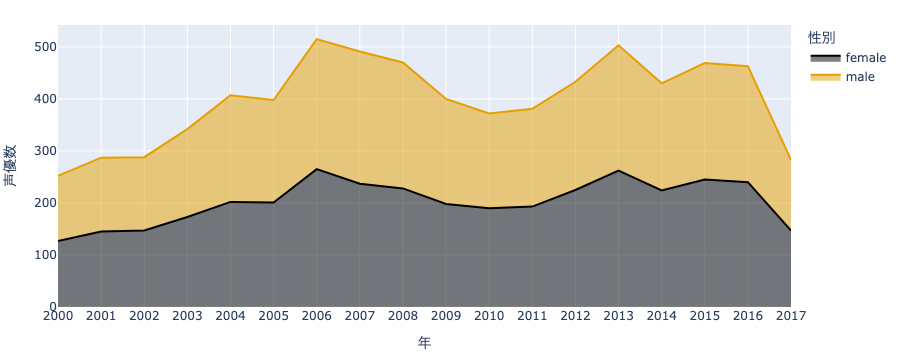

In [42]:
# 積上げ密度プロットを作成し、年ごとの声優数を可視化
# x軸に年、y軸に声優数を設定し、colorに性別を指定
# color_discrete_sequenceで色の配列をOKABE_ITOカラースキームに設定
fig = px.area(
    df_an, x="年", y="声優数", color="性別", color_discrete_sequence=OKABE_ITO
)

# x unifiedを指定することで、同じxに対する複数のyの値を同時に比較できる
fig.update_layout(hovermode="x unified")

# 積上げ密度プロットを表示
show_fig(fig)

In [43]:
# 放送年ごとにユニークなアニメ作品（acid）数をカウント
# 特にアニメ作品数が多い放送年トップ10を表示
df_tmp = df_ae.groupby("years")["acid"].nunique().reset_index(name="n_ac")
df_tmp.sort_values("n_ac", ascending=False, ignore_index=True).head(10)

,years,n_ac
0,2016,346
1,2014,332
2,2006,315
3,2007,306
4,2008,302
5,2015,301
6,2013,291
7,2009,267
8,2012,254
9,2005,245


In [44]:
# データフレームを性別でフィルタリング
df_an_m = filter_gender_and_reset_index(df_an, "male")
df_an_f = filter_gender_and_reset_index(df_an, "female")

In [45]:
# 可視化対象のDataFrameを確認
df_an_m.head()

,性別,年,声優数,合計声優数,声優数のシェア
0,male,2000,125,252,0.496032
1,male,2001,142,287,0.494774
2,male,2002,141,288,0.489583
3,male,2003,169,342,0.494152
4,male,2004,205,407,0.503686


In [46]:
# 可視化対象のDataFrameを確認
df_an_f.head()

,性別,年,声優数,合計声優数,声優数のシェア
0,female,2000,127,252,0.503968
1,female,2001,145,287,0.505226
2,female,2002,147,288,0.510417
3,female,2003,173,342,0.505848
4,female,2004,202,407,0.496314


In [47]:
# 可視化対象DataFrameを保存
save_df_to_csv(df_an_m, DIR_OUT_AN, "an_m")
save_df_to_csv(df_an_f, DIR_OUT_AN, "an_f")

DataFrame is saved as '../../../data/an/output/vol2/03/area/an_m.csv'.
DataFrame is saved as '../../../data/an/output/vol2/03/area/an_f.csv'.


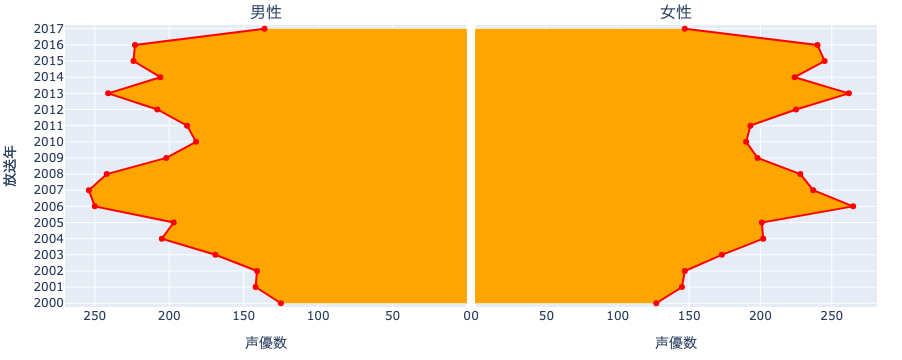

In [48]:
# 人口ピラミッド用の図を作成
fig = make_subplots(
    rows=1, cols=2, subplot_titles=("男性", "女性"), horizontal_spacing=0.01
)

# 図に男性のデータを追加
fig = add_gender_pyramid_trace(fig, df_an_m, "男性", 1)

# 図に女性のデータを追加
fig = add_gender_pyramid_trace(fig, df_an_f, "女性", 2)

# 男性側のx軸を反転（左向き）し、女性側のY軸の目盛りを消す
fig.update_xaxes(autorange="reversed", row=1, col=1)
fig.update_yaxes(showticklabels=False, row=1, col=2)

# x軸とy軸のタイトルを設定
fig.update_xaxes(title_text="声優数")
fig.update_yaxes(title_text="放送年")

# ホバーモードの設定
fig.update_layout(hovermode="y unified")

# 図を表示
show_fig(fig)

### ゲームデータ

In [49]:
# pandasのread_csv関数でCSVファイルの読み込み
df_pkg_pf = pd.read_csv(DIR_GM / FN_PKG_PF)

In [50]:
# df_pkg_pfに年代（1年刻み）を追加
df_pkg_pf = add_years_to_df(df_pkg_pf, unit_years=1)

# date列をdatetimeオブジェクトに変換して、曜日情報を新たな列としてdf_pkg_pfに追加
df_pkg_pf["weekday"] = pd.to_datetime(df_pkg_pf["date"]).dt.weekday

In [51]:
# 各pkgidに対して、関連するweekdayのユニークな数を数える
# groupbyでpkgidごとにグループ化し、nuniqueメソッドで各グループのweekdayのユニークな数を数える
# all関数を使って、nuniqueの結果が全て1であること（各pkgidが1つのweekdayにのみ紐づいていること）を確認
assert all(df_pkg_pf.groupby("pkgid")["weekday"].nunique() == 1)

In [52]:
# years、weekdayごとにpkgidのユニーク数を集計し、n_pkg列として追加
df_gm = (
    df_pkg_pf.groupby(["years", "weekday"])["pkgid"].nunique().reset_index(name="n_pkg")
)

# 数値で表されている曜日を文字列にマッピング
df_gm["yobi"] = df_gm["weekday"].map(WEEKDAY2YOBI)

# 可視化用に列名をリネーム
df_gm = df_gm.rename(
    columns={"years": "発売年", "yobi": "発売曜日", "n_pkg": "パッケージ数"}
)

In [53]:
# 年別のパッケージ数を集計して表示
df_gm.groupby("発売年")["パッケージ数"].sum().reset_index()

,発売年,パッケージ数
0,1982,12
1,1983,11
2,1984,30
3,1985,59
4,1986,57
5,1987,106
6,1988,79
7,1989,152
8,1990,300
9,1991,336


In [54]:
# 1990年から2017年までのデータに絞る
df_gm = df_gm[
    (df_gm["発売年"].astype(int) >= 1990) & (df_gm["発売年"].astype(int) <= 2017)
].reset_index(drop=True)

In [55]:
# 年代別の合計ゲームパッケージ数を集計し、辞書として保存
year2npkg = df_gm.groupby("発売年")["パッケージ数"].sum().to_dict()

# 年をキーに、year2npkgで合計パッケージ数をマッピング
df_gm["合計パッケージ数"] = df_gm["発売年"].map(year2npkg)

# 年ごとのシェアを計算
df_gm["パッケージ数のシェア"] = df_gm["パッケージ数"] / df_gm["合計パッケージ数"]

In [56]:
# 可視化対象のDataFrameを確認
df_gm.head()

,発売年,weekday,パッケージ数,発売曜日,合計パッケージ数,パッケージ数のシェア
0,1990,0,1,月,300,0.003333
1,1990,1,17,火,300,0.056667
2,1990,2,16,水,300,0.053333
3,1990,3,15,木,300,0.050000
4,1990,4,197,金,300,0.656667


In [57]:
# 可視化対象DataFrameを保存
save_df_to_csv(df_gm, DIR_OUT_GM, "gm")

DataFrame is saved as '../../../data/gm/output/vol2/03/area/gm.csv'.


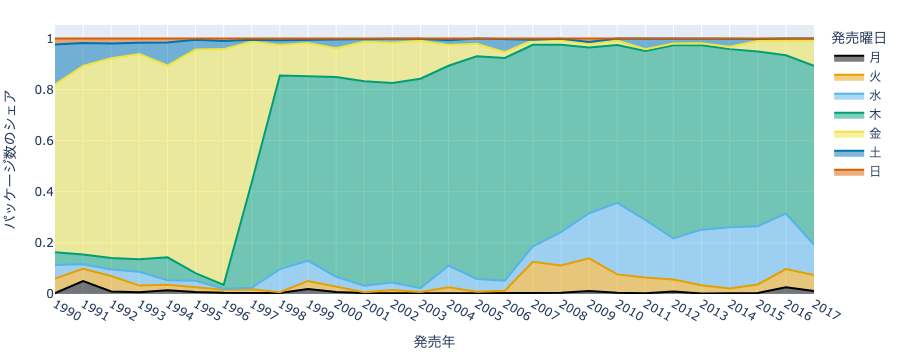

In [58]:
# 積上げ密度プロットを作成し、年ごとのゲームパッケージ数のシェアを可視化
# x軸に年、y軸にパッケージ数のシェアを設定し、colorに曜日を指定
# color_discrete_sequenceで色の配列をOKABE_ITOカラースキームに設定
fig = px.area(
    df_gm,
    x="発売年",
    y="パッケージ数のシェア",
    color="発売曜日",
    color_discrete_sequence=OKABE_ITO,
)

# x unifiedを指定することで、同じxに対する複数のyの値を同時に比較できる
fig.update_layout(hovermode="x unified")

# 積上げ密度プロットを表示
show_fig(fig)

(area-gm-pkg)=

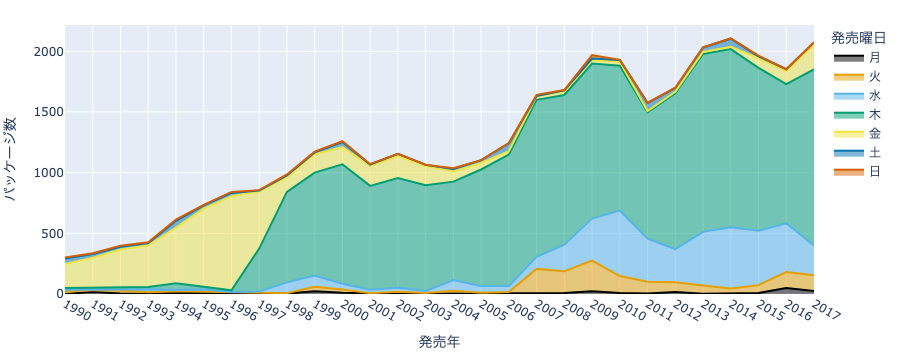

In [59]:
# 積上げ密度プロットを作成し、年ごとのゲームパッケージ数を可視化
# x軸に年、y軸にパッケージ数を設定し、colorに曜日を指定
# color_discrete_sequenceで色の配列をOKABE_ITOカラースキームに設定
fig = px.area(
    df_gm,
    x="発売年",
    y="パッケージ数",
    color="発売曜日",
    color_discrete_sequence=OKABE_ITO,
)

# x unifiedを指定することで、同じxに対する複数のyの値を同時に比較できる
fig.update_layout(hovermode="x unified")

# 積上げ密度プロットを表示
show_fig(fig)

In [60]:
# ゲームデータ中のweekdayと曜日を全て抽出
weekdays = df_gm["weekday"].unique()
yobis = [WEEKDAY2YOBI[x] for x in weekdays]

In [61]:
# プロット用に年別の合計ゲームパッケージ数を集計
df_gm_total = (
    df_gm.groupby("発売年")["パッケージ数"].sum().reset_index(name="合計パッケージ数")
)

In [62]:
# 可視化対象のDataFrameを確認
df_gm_total.head()

,発売年,合計パッケージ数
0,1990,300
1,1991,336
2,1992,398
3,1993,427
4,1994,613


In [63]:
# 可視化対象DataFrameを保存
save_df_to_csv(df_gm_total, DIR_OUT_GM, "gm_total")

DataFrame is saved as '../../../data/gm/output/vol2/03/area/gm_total.csv'.


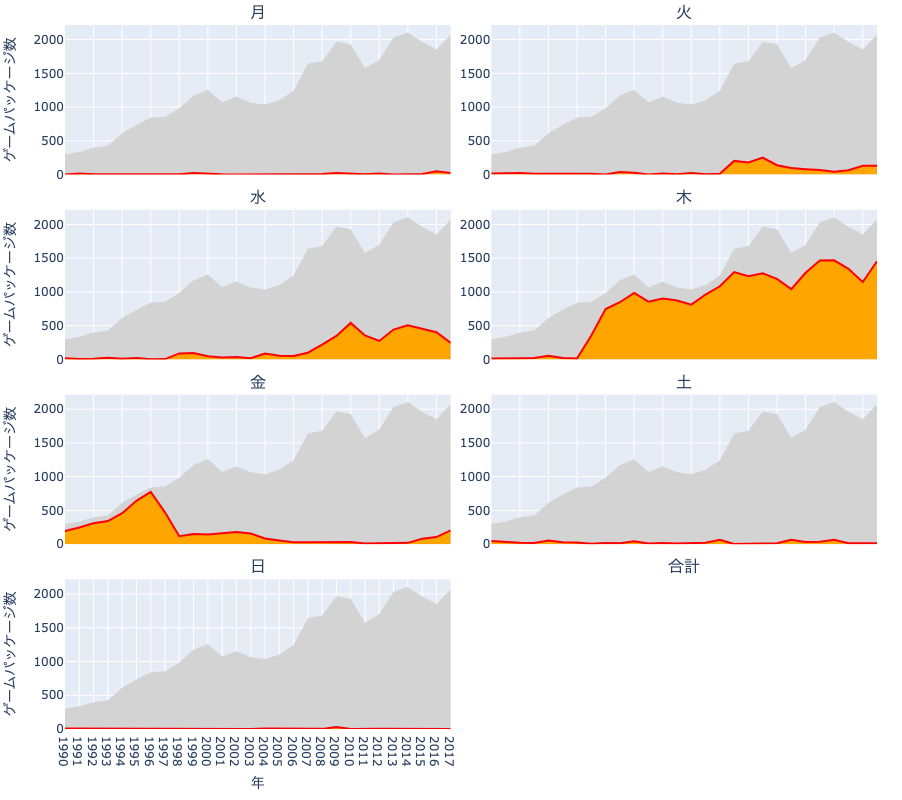

In [64]:
# サブプロットの作成（4行2列のレイアウト）
# shared_xaxes=Trueで全てのサブプロットが同じx軸を共有するように設定
# subplot_titlesに曜日名を指定して各サブプロットにタイトルを設定
# vertical_spacingとhorizontal_spacingでファセット間隔を調整
fig = make_subplots(
    rows=4,
    cols=2,
    shared_xaxes=True,
    subplot_titles=yobis + ["合計"],
    vertical_spacing=0.05,
    horizontal_spacing=0.05,
)

# 各曜日に対してプロットを追加
for i, yobi in enumerate(yobis):
    # 行(row)と列(col)の位置を計算（4行2列のレイアウトを想定）
    row, col = i // 2 + 1, i % 2 + 1

    # 曜日名でデータをフィルタリング
    df_subset = df_gm[df_gm["発売曜日"] == yobi]

    # 全体の合計ゲームパッケージ数の推移を背景に追加
    fig = add_background_trace(
        fig, row, col, df_gm_total["発売年"], df_gm_total["合計パッケージ数"]
    )

    # 曜日別の積上げ密度プロットを追加
    fig = add_density_plot(
        fig, row, col, df_subset["発売年"], df_subset["パッケージ数"], name=yobi
    )

# グラフのレイアウトを調整
# heightでグラフ全体の高さを設定し、showlegend=Falseで凡例を非表示に
fig.update_layout(height=800, showlegend=False)

# y軸のタイトルを左側のサブプロット全てに設定
for row in range(1, 5):
    fig.update_yaxes(title_text="ゲームパッケージ数", row=row, col=1)
# fig.update_yaxes(title_text="ゲームパッケージ数", row=4, col=1)

# x軸のタイトルを下側のサブプロット全てに設定
for col in range(1, 3):
    fig.update_xaxes(title_text="年", row=4, col=col)

# x unifiedを指定することで、同じxに対する複数のyの値を同時に比較できる
fig.update_layout(hovermode="x unified")

# グラフを表示
show_fig(fig)